In [1]:
import numpy as np
import pandas as pd
import boto3
import os
import re
import tensorflow as tf
import matplotlib.pyplot as plt
import plotly.express as px
import random
from plotly.offline import init_notebook_mode
from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Conv2D, MaxPooling2D, GlobalAveragePooling2D, Activation, Dropout, Flatten, Dense, Input, Layer
from tensorflow.keras.applications import VGG16, ResNet50, DenseNet201, Xception
from tensorflow.keras.utils import plot_model

init_notebook_mode(connected=True)

# Product Recommendations System
- A recommender system is a sort of software application or algorithm that provides users with individualized ideas or recommendations. A recommender system's purpose is to forecast a user's preferences or interests and recommend items (such as products, movies, music, articles, and so on) that the user is likely to find relevant or interesting.
- This notebook provides personalized recommendations using content based filtering by helping users discover products that align with their tastes and preferences 
- We will employ K-Nearest Neighbors algorithm to suggest products with visually similar qualities, like those you find on shopping websites, even though we do not have any form of user profile data.

# EDA and Visualization
- Let's first read images and styles csv files
- Then merge the image data and product data to get a single dataframe on which we will run our model
- We will look at some of the categories and subcategories to understand which categories are more dominant

## Images Dataframe

In [2]:
# Set up AWS credentials
access_key = 'AKIAZ54OY********WUEDNE7J'
secret_key = '9cVjnjQ******************************zg'
region = 'us-east-2'
bucket_name = 'fashiondatasetbucket'

file_key_images = 'images.csv'

# Create an S3 client
s3_client = boto3.client('s3', aws_access_key_id=access_key, aws_secret_access_key=secret_key, region_name=region)

# Read the images CSV file
obj_images = s3_client.get_object(Bucket=bucket_name, Key=file_key_images)
images_df = pd.read_csv(obj_images['Body'])

# Display the DataFrame
images_df

,filename,link
0,15970.jpg,http://assets.myntassets.com/v1/images/style/p...
1,39386.jpg,http://assets.myntassets.com/v1/images/style/p...
2,59263.jpg,http://assets.myntassets.com/v1/images/style/p...
3,21379.jpg,http://assets.myntassets.com/v1/images/style/p...
4,53759.jpg,http://assets.myntassets.com/v1/images/style/p...
...,...,...
44441,17036.jpg,http://assets.myntassets.com/v1/images/style/p...
44442,6461.jpg,http://assets.myntassets.com/v1/images/style/p...
44443,18842.jpg,http://assets.myntassets.com/v1/images/style/p...
44444,46694.jpg,http://assets.myntassets.com/v1/images/style/p...


## Product Meta Data Dataframe

In [3]:
file_key_styles = 'styles.csv'

# Read the images CSV file
obj_styles = s3_client.get_object(Bucket=bucket_name, Key=file_key_styles)
styles_df = pd.read_csv(obj_styles['Body'], on_bad_lines='skip')

# Display the DataFrame
styles_df

,id,gender,masterCategory,subCategory,articleType,baseColour,season,year,usage,productDisplayName
0,15970,Men,Apparel,Topwear,Shirts,Navy Blue,Fall,2011.0,Casual,Turtle Check Men Navy Blue Shirt
1,39386,Men,Apparel,Bottomwear,Jeans,Blue,Summer,2012.0,Casual,Peter England Men Party Blue Jeans
2,59263,Women,Accessories,Watches,Watches,Silver,Winter,2016.0,Casual,Titan Women Silver Watch
3,21379,Men,Apparel,Bottomwear,Track Pants,Black,Fall,2011.0,Casual,Manchester United Men Solid Black Track Pants
4,53759,Men,Apparel,Topwear,Tshirts,Grey,Summer,2012.0,Casual,Puma Men Grey T-shirt
...,...,...,...,...,...,...,...,...,...,...
44419,17036,Men,Footwear,Shoes,Casual Shoes,White,Summer,2013.0,Casual,Gas Men Caddy Casual Shoe
44420,6461,Men,Footwear,Flip Flops,Flip Flops,Red,Summer,2011.0,Casual,Lotto Men's Soccer Track Flip Flop
44421,18842,Men,Apparel,Topwear,Tshirts,Blue,Fall,2011.0,Casual,Puma Men Graphic Stellar Blue Tshirt
44422,46694,Women,Personal Care,Fragrance,Perfume and Body Mist,Blue,Spring,2017.0,Casual,Rasasi Women Blue Lady Perfume


## Create Unique ID in both Dataframes

In [4]:
images_df['id'] = images_df['filename'].str.replace(".jpg", "", regex=False).astype(int)
images_df

,filename,link,id
0,15970.jpg,http://assets.myntassets.com/v1/images/style/p...,15970
1,39386.jpg,http://assets.myntassets.com/v1/images/style/p...,39386
2,59263.jpg,http://assets.myntassets.com/v1/images/style/p...,59263
3,21379.jpg,http://assets.myntassets.com/v1/images/style/p...,21379
4,53759.jpg,http://assets.myntassets.com/v1/images/style/p...,53759
...,...,...,...
44441,17036.jpg,http://assets.myntassets.com/v1/images/style/p...,17036
44442,6461.jpg,http://assets.myntassets.com/v1/images/style/p...,6461
44443,18842.jpg,http://assets.myntassets.com/v1/images/style/p...,18842
44444,46694.jpg,http://assets.myntassets.com/v1/images/style/p...,46694


## Merging the Two Dataframes

In [5]:
products_df = styles_df.merge(images_df,on='id',how='left').reset_index(drop=True)

In [6]:
# Concatenate the directory path and the filenames
products_df['filename'] = "C:/Users/aman.sheth/Desktop/archive/fashion-dataset/images/" + products_df['filename']

In [7]:
# List all the image files 
image_files = os.listdir("C:/Users/aman.sheth/Desktop/archive/fashion-dataset/images")

## Removing Products for which images are not present

In [8]:
# Check the filename if it exists or not
products_df['file_found'] = products_df['id'].apply(lambda x: f"{x}.jpg" in image_files)

In [9]:
# Filter the column to only include True values
products_df = products_df[products_df['file_found']].reset_index(drop=True)

## Final Data

In [10]:
products_df.head()

,id,gender,masterCategory,subCategory,articleType,baseColour,season,year,usage,productDisplayName,filename,link,file_found
0,15970,Men,Apparel,Topwear,Shirts,Navy Blue,Fall,2011.0,Casual,Turtle Check Men Navy Blue Shirt,C:/Users/aman.sheth/Desktop/archive/fashion-da...,http://assets.myntassets.com/v1/images/style/p...,True
1,39386,Men,Apparel,Bottomwear,Jeans,Blue,Summer,2012.0,Casual,Peter England Men Party Blue Jeans,C:/Users/aman.sheth/Desktop/archive/fashion-da...,http://assets.myntassets.com/v1/images/style/p...,True
2,59263,Women,Accessories,Watches,Watches,Silver,Winter,2016.0,Casual,Titan Women Silver Watch,C:/Users/aman.sheth/Desktop/archive/fashion-da...,http://assets.myntassets.com/v1/images/style/p...,True
3,21379,Men,Apparel,Bottomwear,Track Pants,Black,Fall,2011.0,Casual,Manchester United Men Solid Black Track Pants,C:/Users/aman.sheth/Desktop/archive/fashion-da...,http://assets.myntassets.com/v1/images/style/p...,True
4,53759,Men,Apparel,Topwear,Tshirts,Grey,Summer,2012.0,Casual,Puma Men Grey T-shirt,C:/Users/aman.sheth/Desktop/archive/fashion-da...,http://assets.myntassets.com/v1/images/style/p...,True


## Checking for Null Values

In [11]:
products_df.isnull().sum()

id                      0
gender                  0
masterCategory          0
subCategory             0
articleType             0
baseColour             15
season                 21
year                    1
usage                 317
productDisplayName      7
filename                0
link                    0
file_found              0
dtype: int64

## Visualizations
- Main Categories Count
- Sub Categories Count
- Products by Season Count
- Product Usage type Count

In [12]:
fig = px.bar(products_df.groupby('masterCategory').count().reset_index(), x='masterCategory',y='id',title='Count per Product Category')
fig.update_layout(barmode='stack', xaxis={'categoryorder':'total descending'})

In [13]:
fig = px.bar(products_df.groupby('subCategory').count().reset_index(), x='subCategory',y='id',title='Count per Product Sub-category', color='subCategory')
fig.update_layout(barmode='stack', xaxis={'categoryorder':'total descending'})

In [14]:
fig = px.bar(products_df.groupby('season').count().reset_index(), x='season', y='id', title='Count per Season Category')
fig.update_layout(barmode='stack', xaxis={'categoryorder':'total descending'})

In [15]:
fig = px.bar(products_df.groupby('usage').count().reset_index(), x='usage', y='id', title='Count per Usage Category')
fig.update_layout(barmode='stack', xaxis={'categoryorder':'total descending'})

## Remove Unneccessary Columns

In [16]:
products_df.drop(columns=['productDisplayName','link','file_found'],inplace=True)

In [17]:
pd.set_option('display.max_colwidth', None)

# Train-Val Split
- Shuffle the data randomly 
- 80% data for train
- 20% data for validation

In [18]:
products_df = products_df.sample(frac=1).reset_index(drop=True)
length = len(products_df)
train_df = products_df.iloc[:int(length*0.8),:]
val_df = products_df.iloc[int(length*0.8):,:].reset_index(drop=True)

## Data Generator

The following code utilizes the `ImageDataGenerator` from the Keras library [@Chollet2018]:

In [19]:
datagen = ImageDataGenerator(rescale=1/255.)

train_gen = datagen.flow_from_dataframe(dataframe=train_df,
                                             target_size=(256,256),
                                             x_col='filename',
                                             class_mode=None,
                                             batch_size=32,
                                             shuffle=False)

val_gen = datagen.flow_from_dataframe(dataframe=val_df,
                                             target_size=(256,256),
                                             x_col='filename',
                                             class_mode=None,
                                             batch_size=32,
                                             shuffle=False)



Found 35535 validated image filenames.
Found 8884 validated image filenames.


[@Chollet2018]: Chollet, F. (2018) Deep Learning with Python. Manning Publications.

# Feature Extraction: Pre-trained VGG16 
- Extract features of the image using the pre-trained deep neural VGG16 network
- Use global average pooling on the final convolutional block of the network

In [20]:
base_model = VGG16(include_top=False,input_shape=(256,256,3))

model = Sequential()
for layer in base_model.layers:
    model.add(layer)
model.add(GlobalAveragePooling2D())
model.summary()



Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 block1_conv1 (Conv2D)       (None, 256, 256, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 256, 256, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 128, 128, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 128, 128, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 128, 128, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 64, 64, 128)       0         
                                                                 
 block3_conv1 (Conv2D)       (None, 64, 64, 256)      

## Extracting Features of Training and Validation Set

In [21]:
train_ftrs = model.predict(train_gen,verbose=1)
val_ftrs = model.predict(val_gen,verbose=1)

278/278 [==============================] - 979s 4s/step


# Dimensionality Reduction
- The features extracted using the VGG16 Network product a vector of 512 features. We will then check if we can reduce the dimenion of the matrix
- We will now perform PCA and see the variance explanation of the principal components

In [22]:
from sklearn.decomposition import PCA

## Illustration of how PCA finds the axes where the within data variability will be maximum
- Lets proceed with 2 principal components first so that we can visualize them in 2D

<img src="https://miro.medium.com/max/1400/1*37a_i1t1tDxDYT3ZI6Yn8w.gif">

In [23]:
components = PCA(2)
components.fit(train_ftrs)
train_pca = components.transform(train_ftrs)

In [24]:
test_pca = components.fit_transform(val_ftrs)

In [25]:
train_pca = pd.DataFrame(train_pca)
train_df = train_df.iloc[:,0:10]
train_df = train_df.merge(train_pca, how='left', left_index=True, right_index=True)

# Visualization: Principal Components

In [26]:
fig = px.scatter(train_df, x=0, y=1, color="masterCategory", title='Main Category', height=600, labels={
                     "0": "Principal Component 1",
                     "1": "Principal Component 2"})
fig.show()

In [27]:
fig = px.scatter(train_df, x=0, y=1, color="gender", title='Gender', height=600, labels={
                     "0": "Principal Component 1",
                     "1": "Principal Component 2"})
fig.show()

In [28]:
fig = px.scatter(train_df, x=0, y=1, color="subCategory", title='Sub Category', height=600, labels={
                     "0": "Principal Component 1",
                     "1": "Principal Component 2"})
fig.show()

In [29]:
fig = px.scatter(train_df[train_df['season'].notna()], x=0, y=1, color="season", title='Season', height=600, labels={
                     "0": "Principal Component 1",
                     "1": "Principal Component 2"})
fig.show()

In [30]:
fig = px.scatter(train_df[train_df['usage'].notna()], x=0, y=1, color="usage", title='Usage', height=600, labels={
                     "0": "Principal Component 1",
                     "1": "Principal Component 2"})
fig.show()

**Inference:**
- The 2 principal components show a reasonably good separability in terms of main product categories

In [33]:
pca = PCA()
pca.fit(train_ftrs)
train_pca = pca.transform(train_ftrs)
variance_explained = np.cumsum(pca.explained_variance_ratio_)
pcs = range(1,len(variance_explained)+1)

# Reduced Dimensions: 512 -> 317
- Here, the first 317 Principal Components explain 99% of the variance in data. So, we will reduce the image feature dimensions to 317

In [34]:
px.line(x = pcs, y = variance_explained, title = 'Principal Components Cumulative Explained Variance', height=600,  labels={
                     "x": "Principal Components",
                     "y": "Explained Variance"})

In [42]:
val_pca = pca.fit_transform(val_ftrs)[:,:317]
val_pca = pd.DataFrame(val_pca)
val = val_df.iloc[:,0:10]
val = val_df.merge(val_pca, how='left', left_index=True, right_index=True)

In [43]:
X = val.iloc[:,-317:]
y = val['id']

# K-Nearest Neighbours
- Lets use k=6, to recommend 5 most similar looking products as the first one will be the query product itself

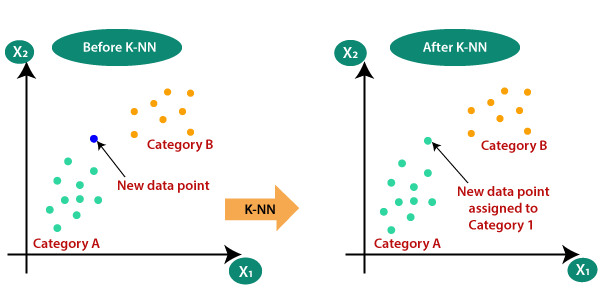

In [44]:
from sklearn.neighbors import KNeighborsClassifier

neigh = KNeighborsClassifier(n_neighbors=9)
neigh.fit(X, y)

KNeighborsClassifier(n_neighbors=9)

In [50]:
def read_img(img_path):
    
    # Load the image from the specified path and resize it to (256, 256, 3)
    img = load_img(img_path,target_size=(256,256,3))
    
    # Convert the image to a NumPy array
    img = img_to_array(img)
    
    # Normalize the pixel values to the range [0, 1]
    img = img/255.
    
    return img

# Results

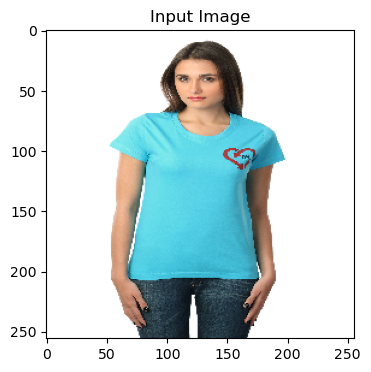

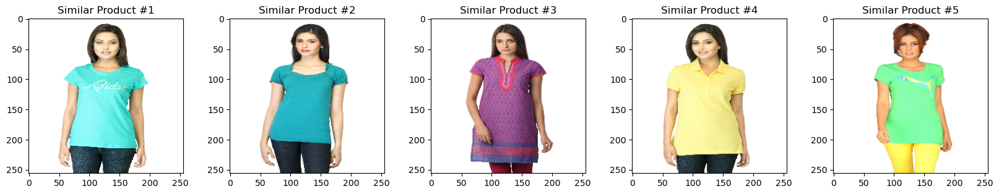

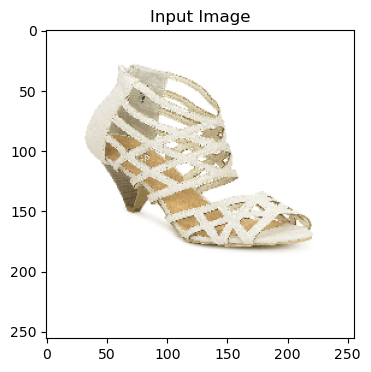

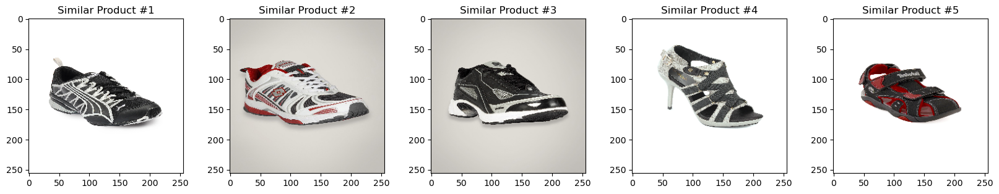

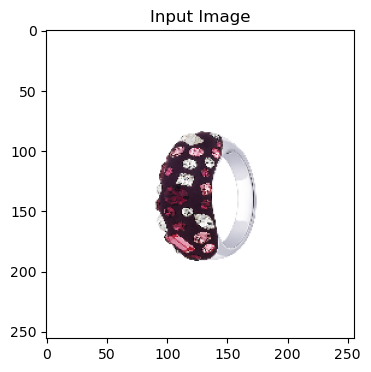

...

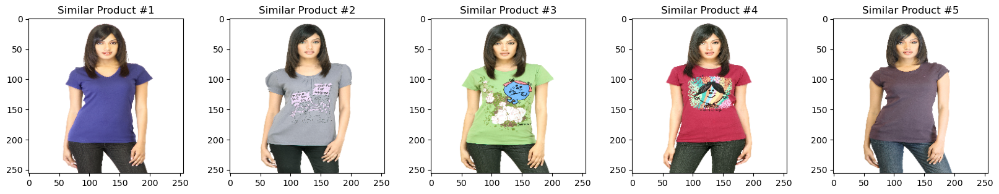

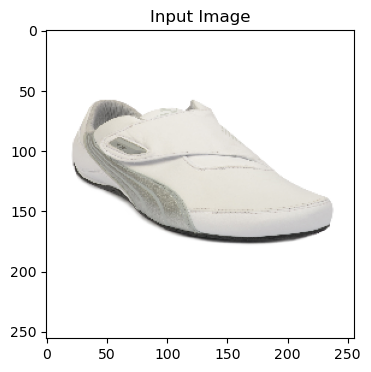

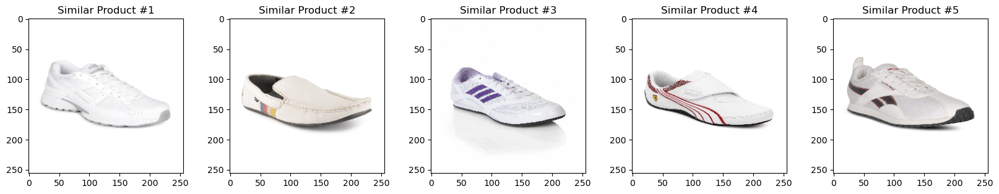

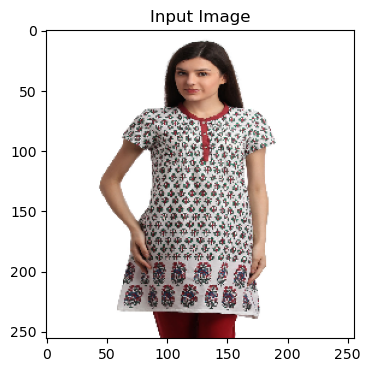

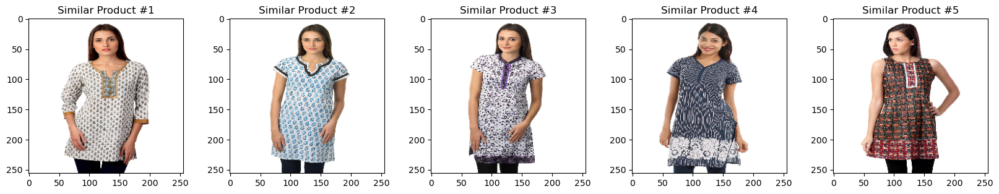

In [51]:
for _ in range(10):
    i = random.randint(1,len(val))
    img1 = read_img(val.loc[i,'filename'])
    dist, index = neigh.kneighbors(X=X.iloc[i,:].values.reshape(1,-1))
    plt.figure(figsize = (4 , 4))
    plt.imshow(img1)
    plt.title("Input Image")

    plt.figure(figsize = (20 , 20))
    for i in range(1,6):
        plt.subplot(1 , 5, i)
        plt.subplots_adjust(hspace = 0.5 , wspace = 0.3)
        image = read_img(val.loc[index[0][i],'filename'])
        plt.imshow(image)
        plt.title(f'Similar Product #{i}')